<a href="https://colab.research.google.com/github/plaban1981/open_cv_projects/blob/main/Meme_Geneartor_using_opencv.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# import the necessary packages
from imutils import face_utils
from imutils import paths
import numpy as np
import argparse
import imutils
import shutil
import json
import dlib
import cv2
import sys
import os

In [ ]:
from google.colab import drive
drive.mount("/content/drive")

Mounted at /content/drive


In [ ]:
def overlay_image(bg, fg, fgMask, coords):
	(sH, sW) = fg.shape[:2]
	(x, y) = coords
	overlay = np.zeros(bg.shape, dtype="uint8")
	overlay[y:y + sH, x:x + sW] = fg
	alpha = np.zeros(bg.shape[:2], dtype="uint8")
	alpha[y:y + sH, x:x + sW] = fgMask
	alpha = np.dstack([alpha] * 3)
	output = alpha_blend(overlay, bg, alpha)
	return output

def alpha_blend(fg, bg, alpha):
	
	fg = fg.astype("float")
	bg = bg.astype("float")
	alpha = alpha.astype("float") / 255
	fg = cv2.multiply(alpha, fg)
	bg = cv2.multiply(1 - alpha, bg)
	output = cv2.add(fg, bg)
	return output.astype("uint8")

def create_gif(inputPath, outputPath, delay, finalDelay, loop):
	
	imagePaths = sorted(list(paths.list_images(inputPath)))
	lastPath = imagePaths[-1]
	imagePaths = imagePaths[:-1];print(imagePaths)
	cmd = "convert -delay {} {} -delay {} {} -loop {} {}".format(delay, " ".join(imagePaths), 
                                                              finalDelay, lastPath, loop,
                                                              outputPath);print(cmd)

	os.system(cmd)


# load the JSON configuration file and the "Deal With It" sunglasses and associated mask

In [ ]:
config = json.loads(open("/content/drive/My Drive/Adrain/opencv-gif-meme/config.json").read())
print(config)
sg = cv2.imread("/content/drive/My Drive/Adrain/opencv-gif-meme/"+ config["sunglasses"])
sgMask = cv2.imread("/content/drive/My Drive/Adrain/opencv-gif-meme/"+config["sunglasses_mask"])

{'face_detector_prototxt': 'assets/deploy.prototxt', 'face_detector_weights': 'assets/res10_300x300_ssd_iter_140000.caffemodel', 'landmark_predictor': 'assets/shape_predictor_68_face_landmarks.dat', 'sunglasses': 'assets/sunglasses.png', 'sunglasses_mask': 'assets/sunglasses_mask.png', 'deal_with_it': 'assets/deal_with_it.png', 'deal_with_it_mask': 'assets/deal_with_it_mask.png', 'min_confidence': 0.5, 'steps': 20, 'delay': 5, 'final_delay': 250, 'loop': 0, 'temp_dir': 'temp'}


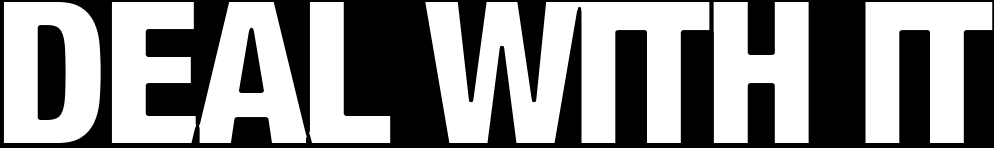

In [ ]:
cv2_imshow(cv2.imread("/content/drive/My Drive/Adrain/opencv-gif-meme/assets/deal_with_it.png"))

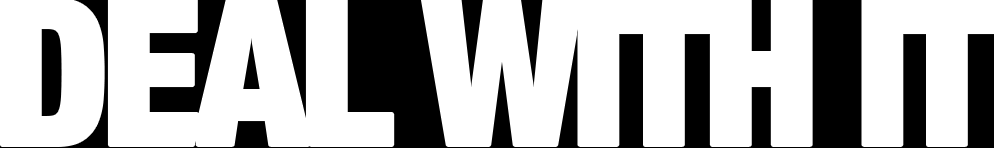

In [ ]:
cv2_imshow(cv2.imread("/content/drive/My Drive/Adrain/opencv-gif-meme/assets/deal_with_it_mask.png"))

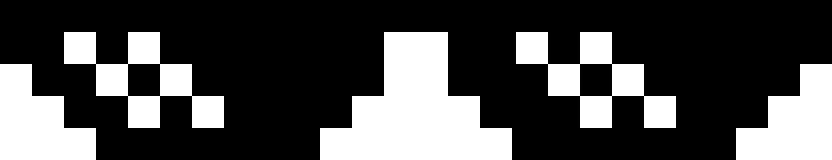

In [ ]:
from google.colab.patches import cv2_imshow
cv2_imshow(sg)

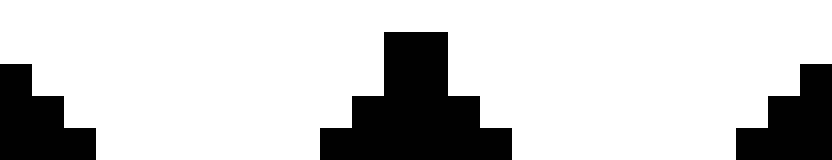

In [ ]:
cv2_imshow(sgMask)

* delete any existing temporary directory (if it exists) and then
* create a new, empty directory where we'll store each individual frame in the GIF

In [ ]:
config["temp_dir"]

'temp'

In [ ]:
shutil.rmtree("/content/temp", ignore_errors=True)
os.makedirs("/content/temp")

# load our OpenCV face detector and dlib facial landmark predictor

In [ ]:
config["landmark_predictor"]

'assets/shape_predictor_68_face_landmarks.dat'

In [ ]:
detector = cv2.dnn.readNetFromCaffe("/content/drive/My Drive/Adrain/opencv-gif-meme/"+config["face_detector_prototxt"],
	"/content/drive/My Drive/Adrain/opencv-gif-meme/"+config["face_detector_weights"])
predictor = dlib.shape_predictor("/content/drive/My Drive/Adrain/opencv-gif-meme/"+config["landmark_predictor"])

# load the input image and construct an input blob from the image

In [ ]:
image = cv2.imread("/content/drive/My Drive/Adrain/opencv-gif-meme/images/BELKIND.jpg")
(H, W) = image.shape[:2]
blob = cv2.dnn.blobFromImage(cv2.resize(image, (300, 300)), 1.0,
	(300, 300), (104.0, 177.0, 123.0))

# pass the blob through the network and obtain the detections

In [ ]:
detector.setInput(blob)
detections = detector.forward()

In [ ]:
detections.shape

(1, 1, 200, 7)

# we'll assume there is only one face we'll be applying the "Deal
# With It" sunglasses to so let's find the detection with the largest
# probability

In [ ]:
i = np.argmax(detections[0, 0, :, 2])
print(i)
confidence = detections[0, 0, i, 2]

0


In [ ]:
confidence,config["min_confidence"]

(0.9999844, 0.5)

# filter out weak detections

In [ ]:
if confidence < config["min_confidence"]:
	print("[INFO] no reliable faces found")
	sys.exit(0)

# compute the (x, y)-coordinates of the bounding box for the face

In [ ]:
W,H

(3264, 4928)

In [ ]:
box = detections[0, 0, i, 3:7] * np.array([W, H, W, H])
(startX, startY, endX, endY) = box.astype("int")

# construct a dlib rectangle object from our bounding box coordinates and then determine the facial landmarks for the face region

In [ ]:
rect = dlib.rectangle(int(startX), int(startY), int(endX), int(endY))
shape = predictor(image, rect)
shape = face_utils.shape_to_np(shape)

# grab the indexes of the facial landmarks for the left and right eye, respectively, then extract (x, y)-coordinates for each eye

In [ ]:
(lStart, lEnd) = face_utils.FACIAL_LANDMARKS_IDXS["left_eye"]
(rStart, rEnd) = face_utils.FACIAL_LANDMARKS_IDXS["right_eye"]
leftEyePts = shape[lStart:lEnd]
rightEyePts = shape[rStart:rEnd]

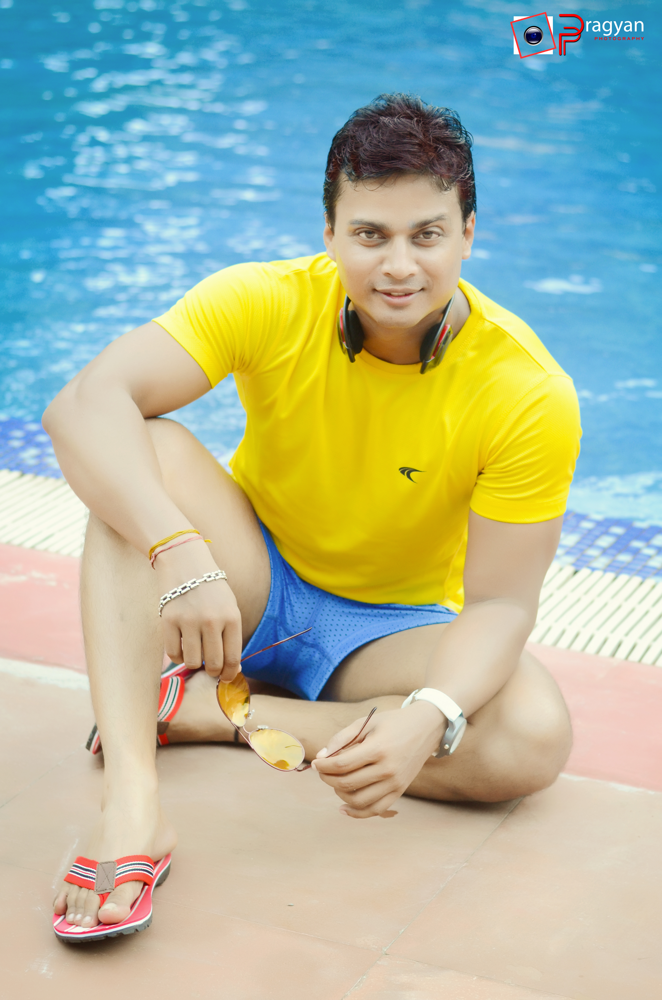

In [ ]:
cv2_imshow(image)

# compute the center of mass for each eye

In [ ]:
leftEyeCenter = leftEyePts.mean(axis=0).astype("int")
rightEyeCenter = rightEyePts.mean(axis=0).astype("int")

In [ ]:
leftEyeCenter,rightEyeCenter

(array([2103, 1162]), array([1832, 1160]))

# compute the angle between the eye centroids

In [ ]:
dY = rightEyeCenter[1] - leftEyeCenter[1]
dX = rightEyeCenter[0] - leftEyeCenter[0]
angle = np.degrees(np.arctan2(dY, dX)) - 180

# rotate the sunglasses image by our computed angle, ensuring the sunglasses will align with how the head is tilted

In [ ]:
sg = imutils.rotate_bound(sg, angle)

In [ ]:
sg.shape

(166, 833, 3)

# the sunglasses shouldn't be the *entire* width of the face and ideally should just cover the eyes -- here we'll do a quick approximation and use 90% of the face width for the sunglasses width

In [ ]:
sgW = int((endX - startX) * 0.9)
sg = imutils.resize(sg, width=sgW)

In [ ]:
sgW

563

our sunglasses contain transparency (the bottom parts, underneath the lenses and nose) so in order to achieve that transparency in the output image we need a mask which we'll use in conjunction with alpha blending to obtain the desired result -- here we're binarizing
our mask and performing the same image processing operations as above

In [ ]:
sgMask = cv2.cvtColor(sgMask, cv2.COLOR_BGR2GRAY)
sgMask = cv2.threshold(sgMask, 0, 255, cv2.THRESH_BINARY)[1]
sgMask = imutils.rotate_bound(sgMask, angle)
sgMask = imutils.resize(sgMask, width=sgW, inter=cv2.INTER_NEAREST)

our sunglasses will drop down from the top of the frame so let's define N equally spaced steps between the top of the frame and the desired end location

In [ ]:
steps = np.linspace(0, rightEyeCenter[1], config["steps"],dtype="int")

In [ ]:
steps

array([   0,   61,  122,  183,  244,  305,  366,  427,  488,  549,  610,
        671,  732,  793,  854,  915,  976, 1037, 1098, 1160])

# start looping over the steps

#### **Steps**

* compute our translation values to move the sunglasses both slighty to the left and slightly up -- 

* the reason why we are doing this is so the sunglasses don't *start* directly at the center of our eye, translation helps us shift the sunglasses to adequately cover our entire eyes (otherwise what good are sunglasses!)


In [ ]:
for (i, y) in enumerate(steps):
	shiftX = int(sg.shape[1] * 0.25)
	shiftY = int(sg.shape[0] * 0.35)
	y = max(0, y - shiftY)

	# add the sunglasses to the image
	output = overlay_image(image, sg, sgMask,(rightEyeCenter[0] - shiftX, y))

	# if this is the final step then we need to add the "DEAL WITH
	# IT" text to the bottom of the frame
	if i == len(steps) - 1:
		# load both the "DEAL WITH IT" image and mask from disk,
		# ensuring we threshold the mask as we did for the sunglasses
		dwi = cv2.imread("/content/drive/My Drive/Adrain/opencv-gif-meme/"+config["deal_with_it"])
		dwiMask = cv2.imread("/content/drive/My Drive/Adrain/opencv-gif-meme/"+config["deal_with_it_mask"])
		dwiMask = cv2.cvtColor(dwiMask, cv2.COLOR_BGR2GRAY)
		dwiMask = cv2.threshold(dwiMask, 0, 255,cv2.THRESH_BINARY)[1]

		# resize both the text image and mask to be 80% the width of
		# the output image
		oW = int(W * 0.8)
		dwi = imutils.resize(dwi, width=oW)
		dwiMask = imutils.resize(dwiMask, width=oW,inter=cv2.INTER_NEAREST)

		# compute the coordinates of where the text will go on the
		# output image and then add the text to the image
		oX = int(W * 0.1)
		oY = int(H * 0.8)
		output = overlay_image(output, dwi, dwiMask, (oX, oY))

	# write the output image to our temporary directory
	p = os.path.sep.join([config["temp_dir"], "{}.jpg".format(
		str(i).zfill(8))])
	cv2.imwrite(p, output)


# now that all of our frames have been written to disk we can finally create our output GIF image in the output directory

In [ ]:
config["delay"],config["final_delay"], config["loop"]

(5, 250, 0)

In [ ]:
!mkdir /content/output

In [ ]:
create_gif("/content/temp", "/content/output/out.gif", config["delay"],config["final_delay"], 1)

['/content/temp/00000000.jpg', '/content/temp/00000001.jpg', '/content/temp/00000002.jpg', '/content/temp/00000003.jpg', '/content/temp/00000004.jpg', '/content/temp/00000005.jpg', '/content/temp/00000006.jpg', '/content/temp/00000007.jpg', '/content/temp/00000008.jpg', '/content/temp/00000009.jpg', '/content/temp/00000010.jpg', '/content/temp/00000011.jpg', '/content/temp/00000012.jpg', '/content/temp/00000013.jpg', '/content/temp/00000014.jpg', '/content/temp/00000015.jpg', '/content/temp/00000016.jpg', '/content/temp/00000017.jpg', '/content/temp/00000018.jpg']
convert -delay 5 /content/temp/00000000.jpg /content/temp/00000001.jpg /content/temp/00000002.jpg /content/temp/00000003.jpg /content/temp/00000004.jpg /content/temp/00000005.jpg /content/temp/00000006.jpg /content/temp/00000007.jpg /content/temp/00000008.jpg /content/temp/00000009.jpg /content/temp/00000010.jpg /content/temp/00000011.jpg /content/temp/00000012.jpg /content/temp/00000013.jpg /content/temp/00000014.jpg /conten

# install imagemagick

**imagemagick is not a python package**

In [ ]:
!apt install imagemagick

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following additional packages will be installed:
  fonts-droid-fallback fonts-noto-mono ghostscript gsfonts
  imagemagick-6-common imagemagick-6.q16 libcupsfilters1 libcupsimage2
  libdjvulibre-text libdjvulibre21 libgs9 libgs9-common libijs-0.35
  libjbig2dec0 liblqr-1-0 libmagickcore-6.q16-3 libmagickcore-6.q16-3-extra
  libmagickwand-6.q16-3 libnetpbm10 libwmf0.2-7 netpbm poppler-data
Suggested packages:
  fonts-noto ghostscript-x imagemagick-doc autotrace cups-bsd | lpr | lprng
  enscript gimp gnuplot grads hp2xx html2ps libwmf-bin mplayer povray radiance
  sane-utils texlive-base-bin transfig ufraw-batch inkscape libjxr-tools
  libwmf0.2-7-gtk poppler-utils fonts-japanese-mincho | fonts-ipafont-mincho
  fonts-japanese-gothic | fonts-ipafont-gothic fonts-arphic-ukai
  fonts-arphic-uming fonts-nanum
The following NEW packages will be installed:
  fonts-droid-fallback fonts-noto-mono g

# Delete the temp folder

In [ ]:
shutil.rmtree("/content/temp", ignore_errors=True)

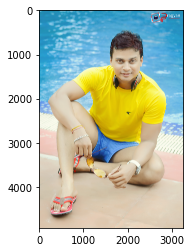

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

img = mpimg.imread("/content/drive/My Drive/Adrain/opencv-gif-meme/images/BELKIND.jpg")
plt.imshow(img)

In [ ]:
fileList = glob("/content/temp/*")

In [ ]:
from imutils import build_montages
# loop over the list of image paths
images = []
for imagePath in fileList:
	# load the image and update the list of images
	image = cv2.imread(imagePath)
	images.append(image)

# construct the montages for the images
montages = build_montages(images, (128, 196), (5, 2))
# loop over the montages and display each of them
for montage in montages:
	cv2_imshow(montage)

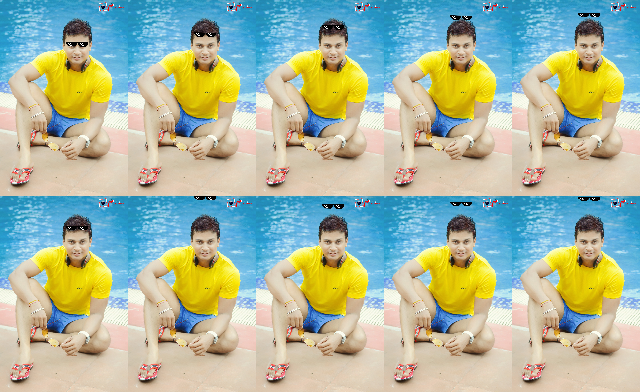

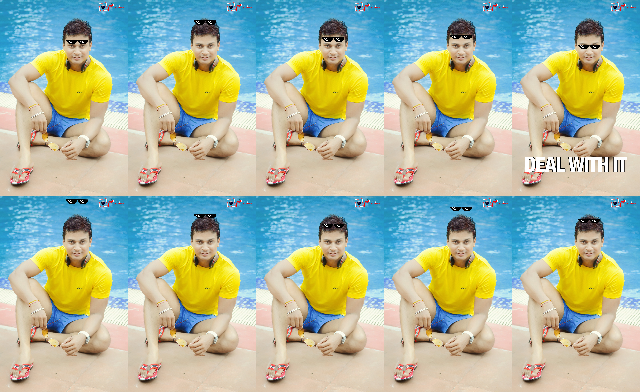

In [ ]:
# construct the montages for the images
montages = build_montages(images, (128, 196), (5, 2))
# loop over the montages and display each of them
for montage in montages:
	cv2_imshow(montage)

FileNotFoundError: ignored

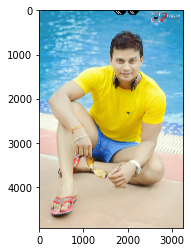

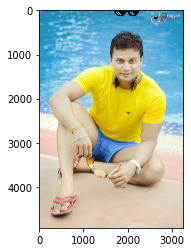

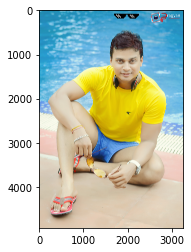

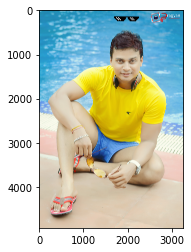

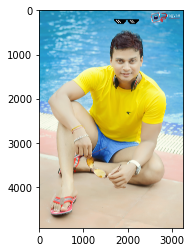

...

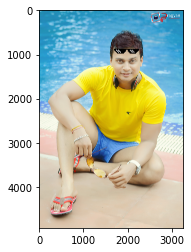

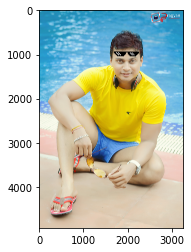

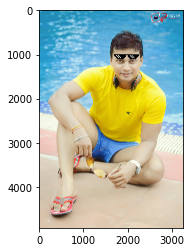

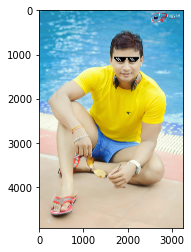

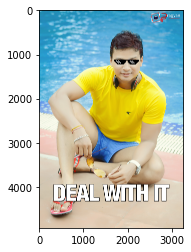

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg



def process(filename: str=None) -> None:
    """
    View multiple images stored in files, stacking vertically

    Arguments:
        filename: str - path to filename containing image
    """
    image = mpimg.imread(filename)
    # <something gets done here>
    plt.figure()
    plt.imshow(image)

for file in fileList:
    process(file)